In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import plotly.express as px

# Set default plotting style
plt.style.use('fivethirtyeight')
# Configure pandas display settings
pd.set_option('display.max_columns', 500)  # Allows you to see very wide pandas DataFrames
# Extract the default color cycle from the current style
color_plt = plt.rcParams['axes.prop_cycle'].by_key()['color']  # List of colors

# FRED API Python Package
from fredapi import Fred
fred_key = '84e6991335beef8a36d6fa6ee93c378b'

In [2]:
#To load Fred Api Key from Kaggle Secret
#from kaggle_secrets import UserSecretsClient 
#secrets = UserSecretsClient() 
#fred_key = secrets.get_secret('fred-api')

In [3]:
# 1] Create the Fred Object [Pull in all the data] 
fred = Fred(api_key=fred_key)

In [4]:
# 2] Search for economic data / indicators 
sp_data = fred.search('S&P', order_by='popularity')

In [5]:
sp_data.shape #1000 because the Fred Search has limit 

(1000, 15)

In [6]:
# 3] Pull Raw data [for one of the series] & Plot 
sp500 = fred.get_series(series_id = 'SP500')  #index: datetime, values: price 

<Axes: title={'center': 'S&P 500'}>

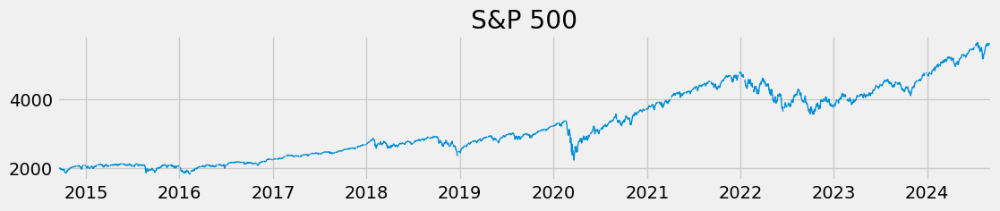

In [7]:
#visualize [Plot] 
sp500.plot(figsize=(12, 2), title='S&P 500', lw=1) 

In [8]:
# 4] Pull few different timeseries datasets & merge them & compare [joining the indicators] 
unemp = fred.search('unemployment') 

<Axes: >

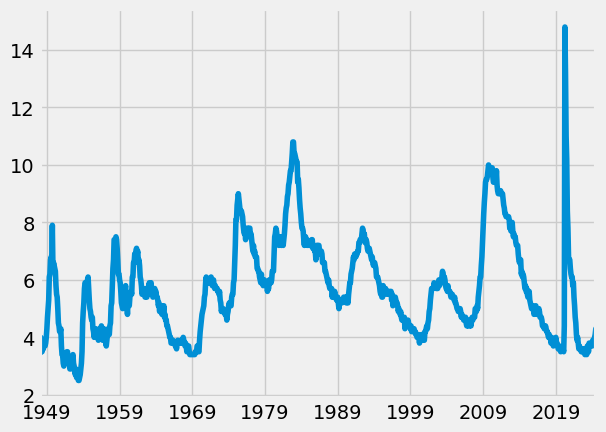

In [9]:
unrate = fred.get_series('unrate')
unrate.plot()

In [10]:
unemp_rate = fred.search('unemployment rate state', filter=('frequency', 'Monthly')) 

In [11]:
unemp_rate = unemp_rate.query('seasonal_adjustment == "Seasonally Adjusted" and units == "Percent"')

In [12]:
unemp_rate = unemp_rate.loc[unemp_rate['title'].str.contains('Unemployment Rate')]

In [13]:
#Go through each Id & pull the data 
#unemp_rate.index

In [14]:
#Gonna join all 
all_results = [] #List that stores all results 

for myid in unemp_rate.index: 
    results = fred.get_series(myid)
    results = results.to_frame(name = myid)
    all_results.append(results) 

In [15]:
#type(all_results)
#all_results[2] #Each all_results have 1 DF, each has its own series 
#pd.concat(all_results, axis = 1)

In [16]:
#Take all results, store it in the list & concat 
unemp_results = pd.concat(all_results, axis = 1).drop(['M08311USM156SNBR'], axis = 1)

<Axes: >

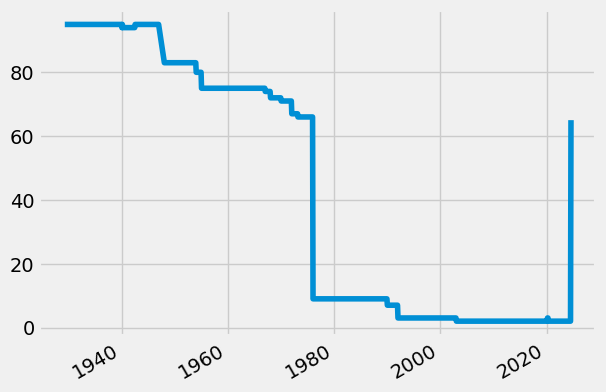

In [17]:
unemp_states = unemp_results.drop('UNRATE', axis=1)
unemp_states.isna().sum(axis=1).plot() #Checked and Plot null values 

In [18]:
#unemp_states = unemp_states.dropna() 

In [19]:
# 5] Plotting with Plotly [States UmEmployment] 
px.line(unemp_states)

<Axes: title={'center': 'Unemployment Rate by States in April 2020'}>

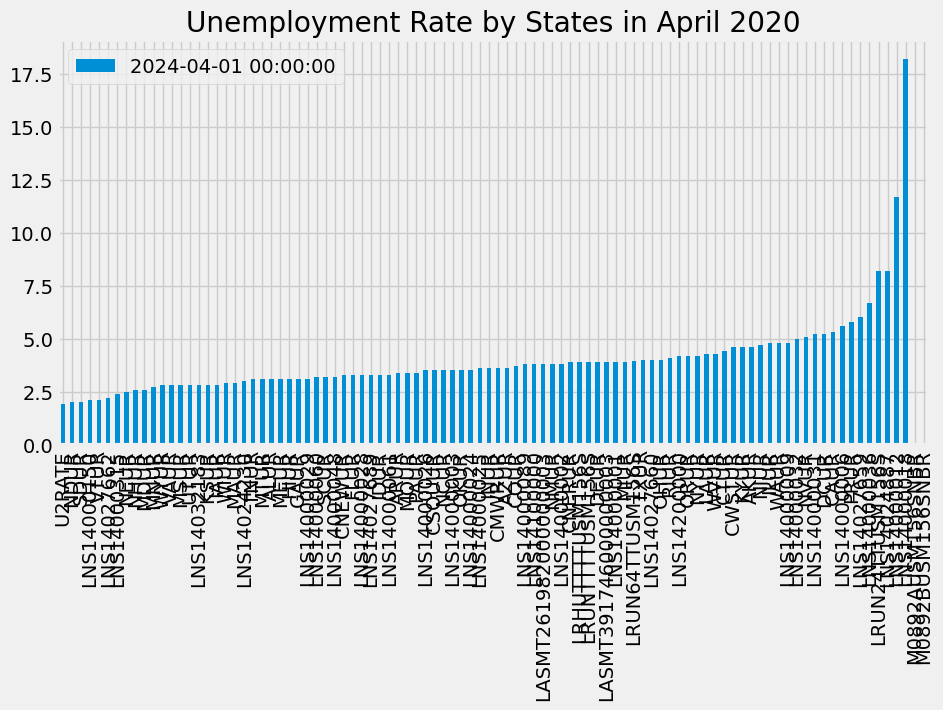

In [20]:
#Can filter states by double click, compare states unemp_rate, Seen big jump in unemp at a point; so pulling each states unemp_rate on that date 
# 6] Pull Apr 2020 UnempRate per state [Bar Chart of unemployment] 
# Locate the index & sort & plot 
unemp_states.loc[unemp_states.index == '2024-04-01'].T \
        .sort_values('2024-04-01') \
        .plot(kind='bar', figsize=(10, 5), 
              title = "Unemployment Rate by States in April 2020")

In [21]:
#Switch the FRED index id to actual state names 
# First, create the id_to_state dictionary properly
id_to_state = unemp_rate.set_index('id')['title'].str.replace('Unemployment Rate ', '').to_dict() #We can map the Ids with the state names by dict

In [22]:
# Then, safely map the state names using list comprehension with .get()
unemp_states.columns = [id_to_state.get(c, c) for c in unemp_states.columns]

In [23]:
# Convert the DataFrame from wide to long format
unemp_states_melted = unemp_states.reset_index().melt(id_vars='index', var_name='variable', value_name='value')
px.line(unemp_states_melted, x='index', y='value', color='variable')  #px.line(unemp_states)

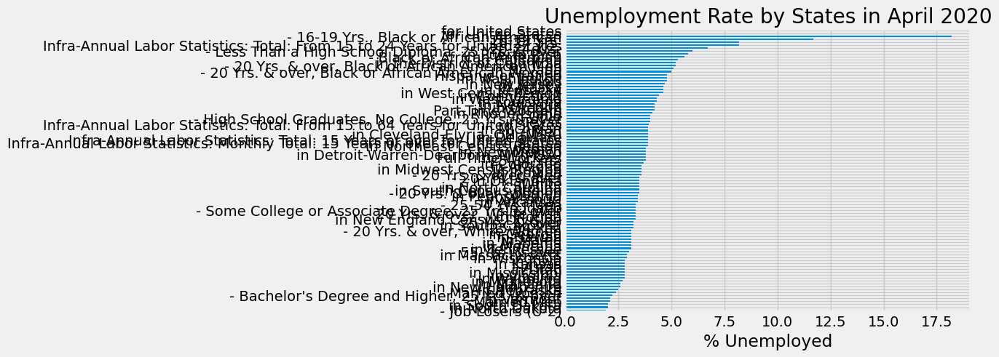

In [24]:
ax = unemp_states.loc[unemp_states.index == '2024-04-01'].T \
        .sort_values('2024-04-01') \
        .plot(kind='barh', title = "Unemployment Rate by States in April 2020")
ax.legend().remove()
ax.set_xlabel('% Unemployed') 
plt.show()

In [25]:
# 7] Another metrics to look in comparision to UR is the PR [Pull PR] 
part_df = fred.search('participation rate state', filter=('frequency','Monthly'))
part_df = part_df.query('seasonal_adjustment == "Seasonally Adjusted" and units == "Percent"')

In [26]:
part_id_to_state = part_df['title'].str.replace('Labor Force Participation Rate','').to_dict()

In [27]:
all_results = []

for myid in part_df.index:
    results = fred.get_series(myid)
    results = results.to_frame(name=myid)
    all_results.append(results)

In [28]:
part_states = pd.concat(all_results, axis=1)
#part_states = part_states.fillna(0)
part_states.columns = [part_id_to_state[c] for c in part_states.columns]

In [29]:
unemp_states.index = pd.to_datetime(unemp_states.index)
part_states.index = pd.to_datetime(part_states.index)

In [30]:
unemp_states.columns = unemp_states.columns.str.strip()
part_states.columns = part_states.columns.str.strip()

In [31]:
# Fix DC
unemp_states = unemp_states.rename(columns={'the District of Columbia':'District Of Columbia'})

State 'in California' not found in the dataset.
State 'in Texas' not found in the dataset.
State 'for United States' not found in the dataset.
State '- 20 Yrs. & over' not found in the dataset.
State 'for United States' not found in the dataset.
State 'in New York' not found in the dataset.
State '- Job Losers (U-2)' not found in the dataset.
State 'in Florida' not found in the dataset.
State 'in Pennsylvania' not found in the dataset.
State 'in Ohio' not found in the dataset.
State 'in Michigan' not found in the dataset.
State 'in Alabama' not found in the dataset.
State '- 16-24 Yrs.' not found in the dataset.
State 'in Massachusetts' not found in the dataset.
State 'in North Carolina' not found in the dataset.
State 'in Illinois' not found in the dataset.
State 'in New Jersey' not found in the dataset.
State 'in Georgia' not found in the dataset.
State 'in Colorado' not found in the dataset.
State 'in Arizona' not found in the dataset.
State 'in Wisconsin' not found in the dataset.


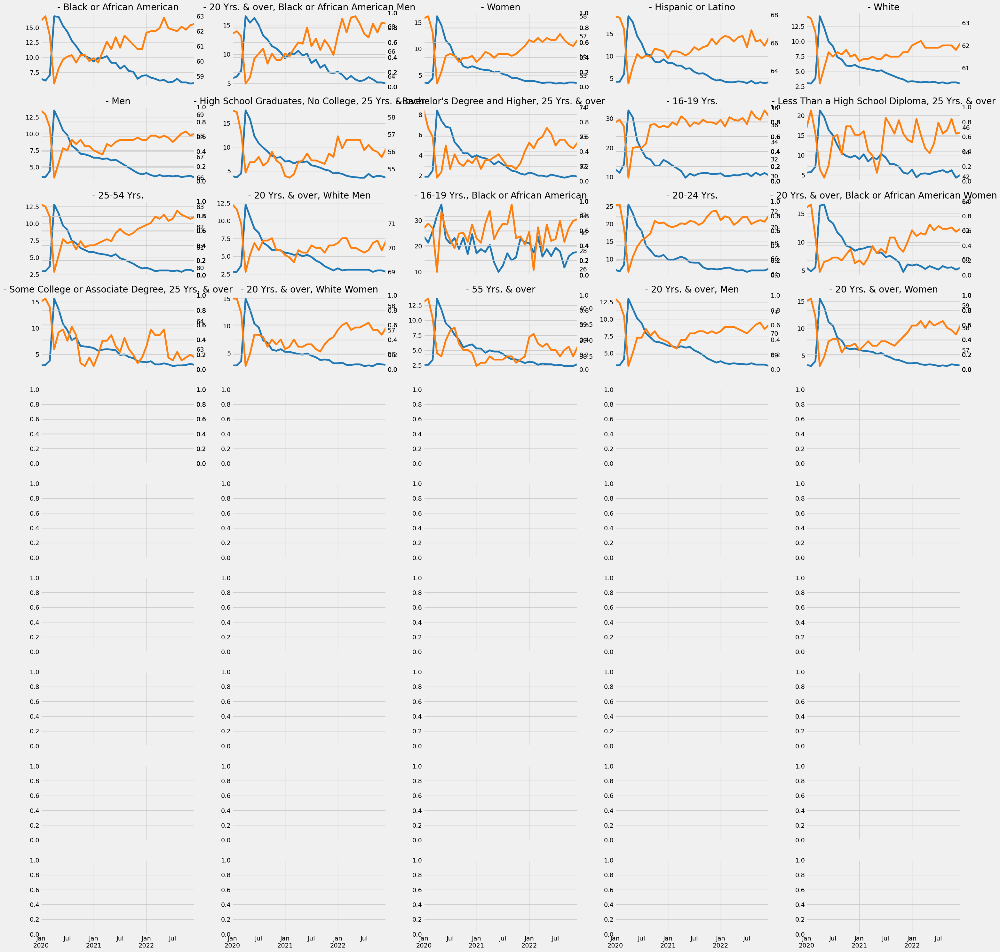

In [32]:
# Define a color palette (you can customize these colors)
color_pal = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', 
             '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

# Create subplots
fig, axs = plt.subplots(10, 5, figsize=(30, 30), sharex=True)
axs = axs.flatten()

i = 0
for state in unemp_states.columns:
    if state in ["District Of Columbia", "Puerto Rico"]:
        continue
    ax2 = axs[i].twinx()
    if state in unemp_states.columns and state in part_states.columns:
        unemp_states_filtered = unemp_states.loc['2020':'2022', state]
        part_states_filtered = part_states.loc['2020':'2022', state]
        unemp_states_filtered.plot(ax=axs[i], label='Unemployment', color=color_pal[0])
        part_states_filtered.plot(ax=ax2, label='Participation', color=color_pal[1])
        ax2.grid(False)
        axs[i].set_title(state)
        i += 1
    else:
        print(f"State '{state}' not found in the dataset.") 
plt.tight_layout()
plt.show()